# The Orchard, Singapore

Types of model used for cancellation prediction:

- Random Forest
- K-Nearest Neighbors
- Neural Network

# Import Libraries

In [1245]:
from pprint import pprint
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PowerTransformer
from imblearn.over_sampling import SMOTE
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from imblearn.pipeline import Pipeline as ImbPipeline

from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier

import matplotlib.pyplot as plt
import seaborn as sns

Define the default font sizes to make the figures prettier:

In [1246]:
plt.rc('font', size=14)
plt.rc('axes', labelsize=14, titlesize=14)
plt.rc('legend', fontsize=14)
plt.rc('xtick', labelsize=10)
plt.rc('ytick', labelsize=10)

# Data Structure Exploration

## Load Data

In [1247]:
data = pd.read_csv('Orchard_dataset.csv')

In [1248]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 20 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   hotel                            119390 non-null  object 
 1   is_cancelled                     119390 non-null  int64  
 2   lead_time                        119390 non-null  int64  
 3   av_daily_rev                     119390 non-null  int64  
 4   arrival_date_year                119390 non-null  int64  
 5   arrival_date_month               119390 non-null  object 
 6   arrival_date_week_number         119390 non-null  int64  
 7   arrival_date_day_of_month        119390 non-null  int64  
 8   stays_in_weekend_nights          119390 non-null  int64  
 9   stays_in_week_nights             119390 non-null  int64  
 10  adults                           119390 non-null  int64  
 11  children                         119386 non-null  float64
 12  ba

## Data Description

In [1249]:
data.describe()

,is_cancelled,lead_time,av_daily_rev,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_cancelled,booking_changes,require_pickup
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119386.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,636.612891,2018.156554,27.165173,15.798241,0.927599,2.500302,1.856403,0.103890,0.007949,0.031912,0.087118,0.137097,0.221124,0.062518
std,0.482918,106.863097,315.852781,0.707476,13.605138,8.780829,0.998613,1.908286,0.579261,0.398561,0.097436,0.175767,0.844336,1.497437,0.652306,0.245291
min,0.000000,0.000000,-40.000000,2017.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,18.000000,433.000000,2018.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,69.000000,591.000000,2018.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,160.000000,788.000000,2019.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,737.000000,33750.000000,2019.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,8.000000


In [1250]:
unique_values = {}
for column in data.columns:
    if data[column].dtype == 'object':
        unique_values[column] = data[column].unique()

pprint(unique_values)

{'arrival_date_month': array(['July', 'August', 'September', 'October', 'November', 'December',
       'January', 'February', 'March', 'April', 'May', 'June'],
      dtype=object),
 'deposit_type': array(['No Deposit', 'Non Refund', 'Refundable'], dtype=object),
 'hotel': array(['RS', 'CT'], dtype=object),
 'room_type': array(['C', 'A', 'D', 'E', 'G', 'F', 'H', 'B', 'L', 'P'], dtype=object)}


## Categorical Attributes

Take a quick look at the categorical attributes:

In [1251]:
data['arrival_date_month'].value_counts()

arrival_date_month
August       13877
July         12661
May          11791
October      11160
April        11089
June         10939
September    10508
March         9794
February      8068
November      6794
December      6780
January       5929
Name: count, dtype: int64

抵达月份大部分是气温暖和的5-10月，暑假、五一、十一小长假，可以联系中国节假日，中国游客是东南亚旅游的主力军。后面在可视化中更直观地表现

In [1252]:
data['room_type'].value_counts()

room_type
A    85994
D    19201
E     6535
F     2897
G     2094
B     1118
C      932
H      601
P       12
L        6
Name: count, dtype: int64

由十个大写字母表示的房间类型，A和D最受欢迎

In [1253]:
data['deposit_type'].value_counts()

deposit_type
No Deposit    104641
Non Refund     14587
Refundable       162
Name: count, dtype: int64

无订金，不可退款，可退款三种，无订金预定最多

## Numerical Attributes

In [1254]:
# Show the summary statistics of other numerical attributes
data.describe()

,is_cancelled,lead_time,av_daily_rev,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_cancelled,booking_changes,require_pickup
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119386.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,636.612891,2018.156554,27.165173,15.798241,0.927599,2.500302,1.856403,0.103890,0.007949,0.031912,0.087118,0.137097,0.221124,0.062518
std,0.482918,106.863097,315.852781,0.707476,13.605138,8.780829,0.998613,1.908286,0.579261,0.398561,0.097436,0.175767,0.844336,1.497437,0.652306,0.245291
min,0.000000,0.000000,-40.000000,2017.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,18.000000,433.000000,2018.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,69.000000,591.000000,2018.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,160.000000,788.000000,2019.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,737.000000,33750.000000,2019.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,8.000000


In [1255]:
# Check that the target is indeed 0 or 1
data["is_cancelled"].value_counts()

is_cancelled
0    75166
1    44224
Name: count, dtype: int64

In [1256]:
data["arrival_date_year"].value_counts()

arrival_date_year
2018    56707
2019    40687
2017    21996
Name: count, dtype: int64

In [1257]:
data["is_repeated_guest"].value_counts()

is_repeated_guest
0    115580
1      3810
Name: count, dtype: int64

# Exploratory Data Analysis (EDA)

## Distribution of the Label Variable

In [1258]:
# Overall proportion
values = data['is_cancelled'].value_counts()
total = values.sum()

percentage_0 = (values[0] /total) * 100
percentage_1 = (values[1]/ total) * 100

print('percentage of not cancelled:' ,percentage_0)
print('percentage of cancelled:' ,percentage_1)

percentage of not cancelled: 62.958371722924866
percentage of cancelled: 37.041628277075134


Plot cancellation rates for each hotel:

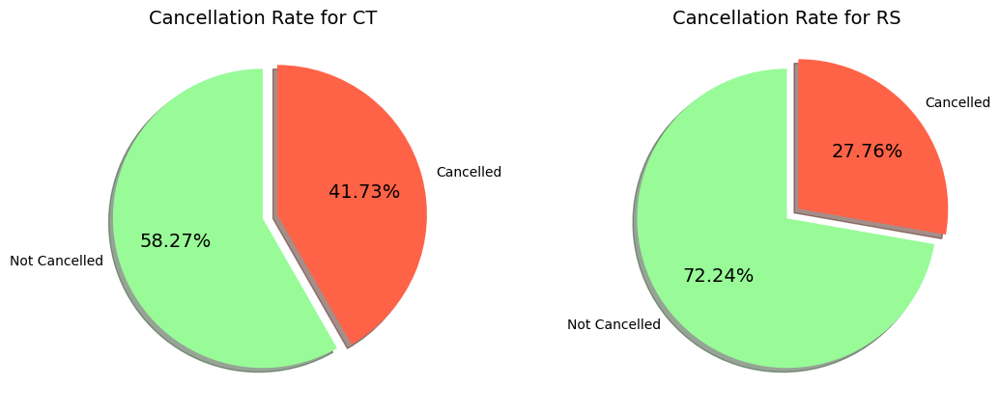

In [1259]:
# Group by the 'hotel' variable and count the number of 'is_cancelled' values for each category
grouped = data.groupby(['hotel', 'is_cancelled']).size().unstack()
# Create a chart with two subgraphs
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

# Draw a pie chart for the 'CT' category
ax1.pie(grouped.loc['CT'],
        labels=['Not Cancelled', 'Cancelled'],
        autopct='%0.2f%%', startangle=90,
        colors=['palegreen', 'tomato'],
        explode=(0, 0.1), shadow=True)
ax1.set_title('Cancellation Rate for CT')

# Draw a pie chart for the 'RS' category
ax2.pie(grouped.loc['RS'],
        labels=['Not Cancelled', 'Cancelled'],
        autopct='%0.2f%%', startangle=90,
         colors=['palegreen', 'tomato'],
        explode=(0, 0.1), shadow=True)
ax2.set_title('Cancellation Rate for RS')

# Adjust the spacing between subgraphs
plt.subplots_adjust(wspace=0.4)

# Show the charts
plt.show()

## Histograms

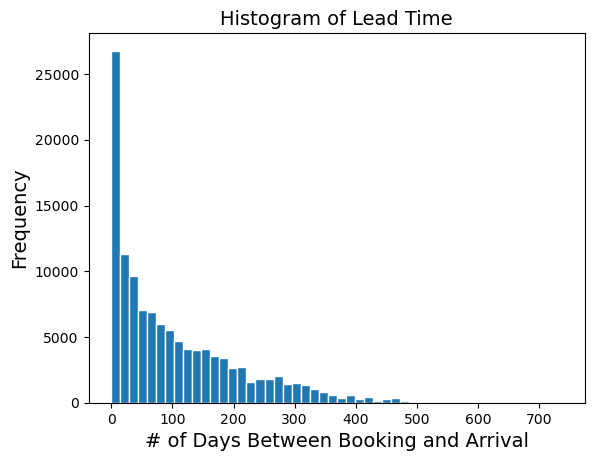

In [1260]:
# Histogram of lead_time
plt.hist(data['lead_time'], bins=50, edgecolor='white')

plt.xlabel('# of Days Between Booking and Arrival')
plt.ylabel('Frequency')
plt.title('Histogram of Lead Time')

plt.show()

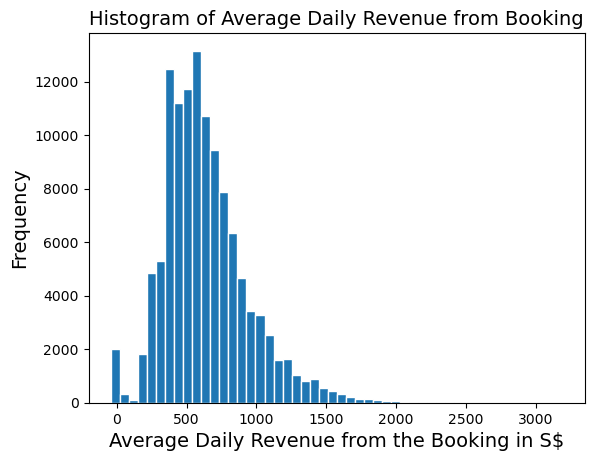

In [1261]:
# Histogram of av_daily_rev
plt.hist(data['av_daily_rev'][data['av_daily_rev'] < 3500],
         bins=50, edgecolor='white') # Capped at 3500

plt.xlabel('Average Daily Revenue from the Booking in S$')
plt.ylabel('Frequency')
plt.title('Histogram of Average Daily Revenue from Booking')

plt.show()

日均收入有<0的，还有>3w的，可能是outliers

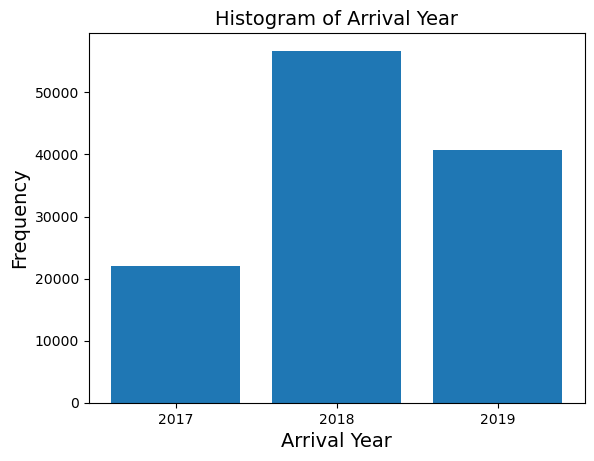

In [1262]:
# Calculate the frequency for each year
value_counts = data['arrival_date_year'].value_counts()

# Histogram of arrival_date_year
plt.bar(value_counts.index, value_counts.values)

plt.xticks([2017, 2018, 2019])
plt.xlabel('Arrival Year')
plt.ylabel('Frequency')
plt.title('Histogram of Arrival Year')

plt.show()

2018年访客激增，2019年又有所下降

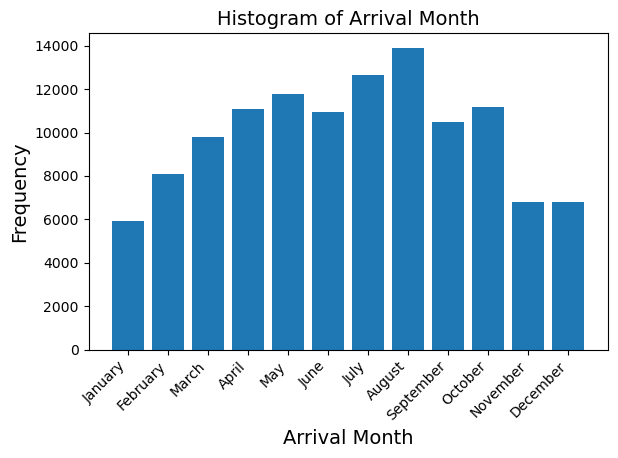

In [1263]:
# Calculate the frequency for each month
month_counts = data['arrival_date_month'].value_counts().sort_index()

# Create a new sequential index
month_labels = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
sorted_month_counts = month_counts.reindex(month_labels) # Reindex

# Histogram of arrival_date_month
plt.bar(range(1, 13), sorted_month_counts)

plt.xlabel('Arrival Month')
plt.ylabel('Frequency')
plt.title('Histogram of Arrival Month')

plt.xticks(range(1, 13), month_labels, rotation=45, ha='right')

plt.tight_layout()
plt.show()

arrival_date_week_number所显示的大致趋势与月份相同，arrival_date_day_of_month则较均匀没有明显趋势。此处没有单独作图，后面可以考虑结合生成新变量“一年中的抵达日”来看。

* 周末/工作日夜晚的数量、成人/儿童/婴儿的人数、以前取消/未取消的次数、更改次数、要求接机次数，这些变量的直方图很相似，都是小值多大值少、有离群值，即tail-heavy。下面给出一例，如果想分析可以修改并查看其他变量，若认为不必分析则可删除此部分。

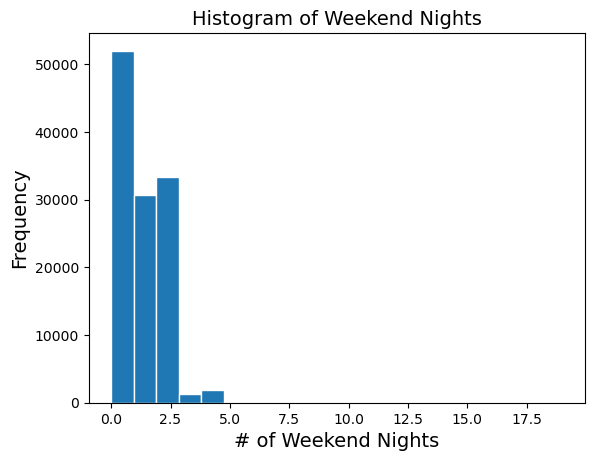

In [1264]:
# Histogram of stays_in_weekend_nights
plt.hist(data['stays_in_weekend_nights'], bins=20, edgecolor='white')

plt.xlabel('# of Weekend Nights')
plt.ylabel('Frequency')
plt.title('Histogram of Weekend Nights')

plt.show()

* 对于这些重尾分布的数值型变量，后面在特征工程中取对数,这是因为大多数机器学习模型不能很好地处理非正态分布的数据。重尾分布是指具有比正态分布更厚的尾部的分布，这意味着极端值（较大或较小的值）出现的可能性更大。尾部的厚度取决于离群值的相对频率和离群值与主要分布之间的差异。如果离群值的频率较低且离群值与主要分布之间存在较大差异，则可以认为这个分布具有重尾特征。如上面的('lead_time', 'av_daily_rev', 'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children', 'babies', 'previous_cancellations', 'previous_bookings_not_cancelled', 'booking_changes', 'require_pickup')都是重尾/长尾分布

* PPT中写到： If distribution of an attribute (to be used in ML training later) is tail-heavy, it may allow small number of large value upset the analysis – take log of the attribute.

Repeat booking and cancellation by hotel:

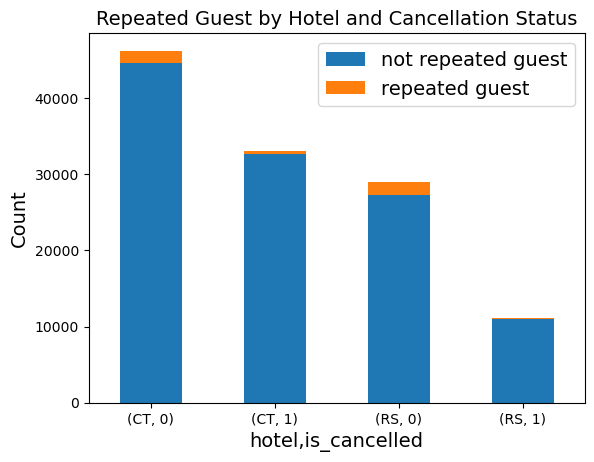

In [1265]:
# Repeated guest account for cancelled and uncancelled guest
counts_1 = data.groupby(['hotel', 'is_cancelled', 'is_repeated_guest']).size().unstack()

# Draw a stacked bar chart
counts_1.plot(kind='bar', stacked=True)

plt.title('Repeated Guest by Hotel and Cancellation Status')
plt.xticks(rotation=0)
plt.ylabel('Count')
plt.legend(['not repeated guest', 'repeated guest'])

plt.show()

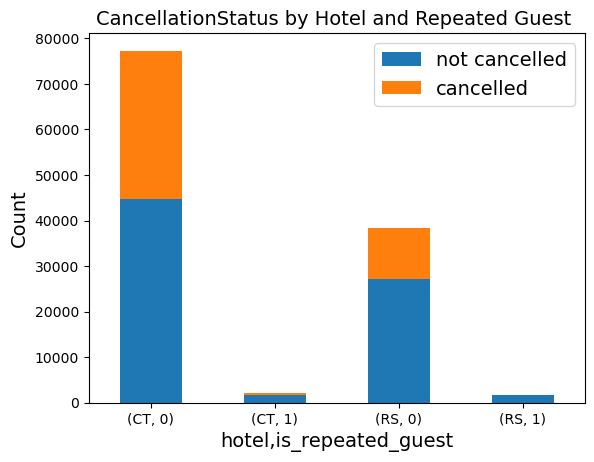

In [1266]:
# Cancelled and uncancelled guest account for repeated guest
counts_2 = data.groupby(['hotel', 'is_repeated_guest', 'is_cancelled']).size().unstack()

# Draw a stacked bar chart
counts_2.plot(kind='bar', stacked=True)

plt.title('CancellationStatus by Hotel and Repeated Guest ')
plt.xticks(rotation=0)
plt.ylabel('Count')
plt.legend(['not cancelled', 'cancelled'])

plt.show()

In [1267]:
percentages = counts_2.div(counts_2.sum(axis=1), axis=0) * 100

print(percentages)

is_cancelled                     0          1
hotel is_repeated_guest                      
CT    0                  57.746643  42.253357
      1                  78.297244  21.702756
RS    0                  71.237135  28.762865
      1                  93.757030   6.242970


CT预定数比RS多，应该是因为商务酒店和度假酒店位置和价格的区别。对这两家酒店，重复预定的客人取消的概率都比较小。CT重复预定的客人中，有78.3%的人未取消，21.7%的人取消了预定,而未重复预定的客人中有42.3%的人取消了预定。RS重复预定的客人中，有93.8%的人未取消，只有6.2%的人取消，而未重复预定的客人中有28.8%的人取消。

/var/folders/x4/gfqzzdp524b6hsvt7cp9ln7m0000gn/T/ipykernel_9329/2555531921.py:17: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



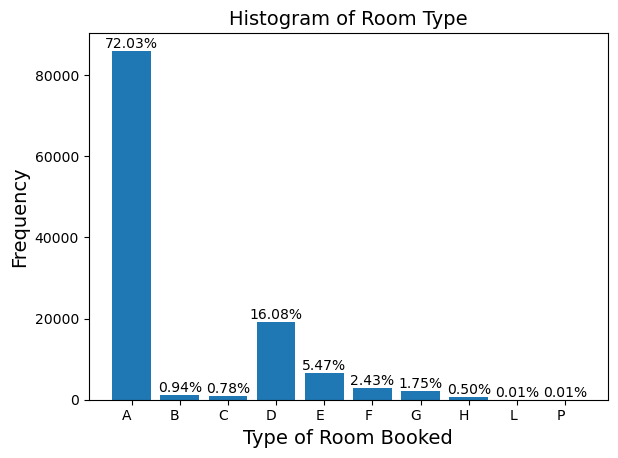

In [1268]:
# Calculate the frequency for each type of room
room_counts = data['room_type'].value_counts().sort_index()

# Create a new sequential index
room_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'L', 'P']
sorted_room_counts = room_counts.reindex(room_labels) # Reindex

# Calculate the percentage for each room type
room_percentages = sorted_room_counts / sorted_room_counts.sum() * 100

# Plot histogram of room_type
fig, ax = plt.subplots()
ax.bar(range(1, 11), sorted_room_counts)

# Add the percentage label
for i, v in enumerate(sorted_room_counts):
    ax.text(i + 1, v + 1, f'{room_percentages[i]:.2f}%', ha='center', va='bottom', fontsize=10)

plt.title('Histogram of Room Type')
plt.xlabel('Type of Room Booked')
plt.ylabel('Frequency')

plt.xticks(range(1, 11), room_labels, ha='right')

plt.tight_layout()
plt.show()

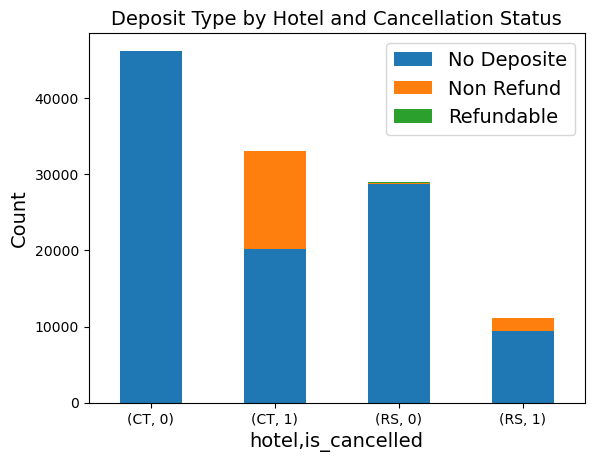

In [1269]:
# Repeated guest account for cancelled and uncancelled guest
counts_3 = data.groupby(['hotel', 'is_cancelled', 'deposit_type']).size().unstack()

# Draw a stacked bar chart
counts_3.plot(kind='bar', stacked=True)

plt.title('Deposit Type by Hotel and Cancellation Status')
plt.xticks(rotation=0)
plt.ylabel('Count')
plt.legend(['No Deposite', 'Non Refund', 'Refundable'])

plt.show()

In [1270]:
percentages = counts_3.div(counts_3.sum(axis=1), axis=0) * 100

print(percentages)

deposit_type        No Deposit  Non Refund  Refundable
hotel is_cancelled                                    
CT    0              99.935104    0.051917    0.012979
      1              61.156426   38.801281    0.042294
RS    0              99.346880    0.238441    0.414680
      1              84.966733   14.835461    0.197806


绝大部分未取消的预定都是无订金的，绝大部分不退款的都取消了预定，这是为什么？

# Data Preprocessing

## Missing Values

In [1271]:
data.isna().sum().sort_values(ascending=False)

children                           4
hotel                              0
is_cancelled                       0
deposit_type                       0
booking_changes                    0
room_type                          0
previous_bookings_not_cancelled    0
previous_cancellations             0
is_repeated_guest                  0
babies                             0
adults                             0
stays_in_week_nights               0
stays_in_weekend_nights            0
arrival_date_day_of_month          0
arrival_date_week_number           0
arrival_date_month                 0
arrival_date_year                  0
av_daily_rev                       0
lead_time                          0
require_pickup                     0
dtype: int64

In [1272]:
data.shape

(119390, 20)

In [1273]:
data.dropna(inplace=True)
data.isna().values.any()

False

In [1274]:
data.shape

(119386, 20)

## Convert Data Types

In [1275]:
data.dtypes

hotel                               object
is_cancelled                         int64
lead_time                            int64
av_daily_rev                         int64
arrival_date_year                    int64
arrival_date_month                  object
arrival_date_week_number             int64
arrival_date_day_of_month            int64
stays_in_weekend_nights              int64
stays_in_week_nights                 int64
adults                               int64
children                           float64
babies                               int64
is_repeated_guest                    int64
previous_cancellations               int64
previous_bookings_not_cancelled      int64
room_type                           object
booking_changes                      int64
deposit_type                        object
require_pickup                       int64
dtype: object

### Categorical Data

In [1276]:
categorical_column = ['hotel', 'room_type', 'deposit_type']
boolean_column = ['is_cancelled', 'is_repeated_guest']

boolean_map = {0: 'No', 1: 'Yes'}
data['is_cancelled'] = data['is_cancelled'].map(boolean_map)
data['is_repeated_guest'] = data['is_repeated_guest'].map(boolean_map)

data[categorical_column + boolean_column] = data[categorical_column + boolean_column].astype('category')

print("Data types after categorical data conversion:")
pprint(data.dtypes)

print("First 5 rows of the data:")
pprint(data.head())

Data types after categorical data conversion:
hotel                              category
is_cancelled                       category
lead_time                             int64
av_daily_rev                          int64
arrival_date_year                     int64
arrival_date_month                   object
arrival_date_week_number              int64
arrival_date_day_of_month             int64
stays_in_weekend_nights               int64
stays_in_week_nights                  int64
adults                                int64
children                            float64
babies                                int64
is_repeated_guest                  category
previous_cancellations                int64
previous_bookings_not_cancelled       int64
room_type                          category
booking_changes                       int64
deposit_type                       category
require_pickup                        int64
dtype: object
First 5 rows of the data:
  hotel is_cancelled  lead_time  a

### Numerical Data

In [1277]:
data['children'].apply(float.is_integer).all()

True

In [1278]:
data['children'] = data['children'].astype('int')

print("Data types after numerical data conversion:")
pprint(data.dtypes)

Data types after numerical data conversion:
hotel                              category
is_cancelled                       category
lead_time                             int64
av_daily_rev                          int64
arrival_date_year                     int64
arrival_date_month                   object
arrival_date_week_number              int64
arrival_date_day_of_month             int64
stays_in_weekend_nights               int64
stays_in_week_nights                  int64
adults                                int64
children                              int64
babies                                int64
is_repeated_guest                  category
previous_cancellations                int64
previous_bookings_not_cancelled       int64
room_type                          category
booking_changes                       int64
deposit_type                       category
require_pickup                        int64
dtype: object


## Data Cleaning

### Arrival Date

In [1279]:
arrive_date_columns = ['arrival_date_year', 'arrival_date_month', 'arrival_date_day_of_month']
data['arrival_date_day_of_month'] = data['arrival_date_day_of_month'].apply(lambda x: f"{int(x):02d}")
data[arrive_date_columns].apply(lambda x: '-'.join(x.values.astype(str)), axis=1)

0           2017-July-01
1           2017-July-01
2           2017-July-01
3           2017-July-01
4           2017-July-01
               ...      
119385    2019-August-31
119386    2019-August-31
119387    2019-August-31
119388    2019-August-31
119389    2019-August-31
Length: 119386, dtype: object

In [1280]:
def is_valid_date(x):
    try:
        pd.to_datetime('-'.join(x.values.astype(str)), format='%Y-%B-%d')
        return True
    except ValueError:
        return False

invalid_dates = data[arrive_date_columns].apply(lambda x: not is_valid_date(x), axis=1)
data.drop(data[invalid_dates].index, inplace=True)
pprint(data.shape)

(119290, 20)


# Feature Engineering

## Arrival Date

In [1281]:
data['arrival_date'] = pd.to_datetime(data[arrive_date_columns].apply(lambda x: '-'.join(x.values.astype(str)), axis=1), format='%Y-%B-%d')
data.drop(columns=arrive_date_columns + ['arrival_date_week_number'], inplace=True)
data[['arrival_date']].head()

,arrival_date
0,2017-07-01
1,2017-07-01
2,2017-07-01
3,2017-07-01
4,2017-07-01


## Booking Date

In [1282]:
data['booking_date'] = data['arrival_date'] - pd.to_timedelta(data['lead_time'], unit='D')
data[['booking_date', 'arrival_date', 'lead_time', 'is_cancelled']].head()

,booking_date,arrival_date,lead_time,is_cancelled
0,2016-07-24,2017-07-01,342,No
1,2015-06-25,2017-07-01,737,No
2,2017-06-24,2017-07-01,7,No
3,2017-06-18,2017-07-01,13,No
4,2017-06-17,2017-07-01,14,No


## Outliers

In [1283]:
pprint(data.dtypes)

hotel                                    category
is_cancelled                             category
lead_time                                   int64
av_daily_rev                                int64
stays_in_weekend_nights                     int64
stays_in_week_nights                        int64
adults                                      int64
children                                    int64
babies                                      int64
is_repeated_guest                        category
previous_cancellations                      int64
previous_bookings_not_cancelled             int64
room_type                                category
booking_changes                             int64
deposit_type                             category
require_pickup                              int64
arrival_date                       datetime64[ns]
booking_date                       datetime64[ns]
dtype: object


In [1284]:
data['total_guests'] = data['adults'] + data['children'] + data['babies']
data['total_nights'] = data['stays_in_weekend_nights'] + data['stays_in_week_nights']

In [1285]:
int_columns = data.select_dtypes(include='int64').columns  # 获取数据中所有整数类型列的列名

# 为每个整数列创建一个条形图
for column in int_columns:
    fig = px.histogram(data, x=column, title=f'{column} distribution', text_auto=True)  # 创建条形图，x轴为列名，标题为列名的分布
    fig.show()  # 显示图形

In [1286]:
data[data['is_cancelled'] == 'Yes']['total_guests'].value_counts().sort_index()

total_guests
0        25
1      6552
2     32535
3      3374
4      1646
5        34
6         1
10        1
12        1
20        2
26        5
27        2
40        1
50        1
55        1
Name: count, dtype: int64

In [1287]:
data[data['total_guests'] == 55]['room_type']

12318    A
Name: room_type, dtype: category
Categories (10, object): ['A', 'B', 'C', 'D', ..., 'G', 'H', 'L', 'P']

In [1288]:
data[data['room_type'] == 'A']['total_guests'].value_counts().sort_index()

total_guests
0       121
1     19952
2     61350
3      4421
4        57
5         3
10        1
26        5
27        2
40        1
50        1
55        1
Name: count, dtype: int64

In [1289]:
data[data['is_cancelled'] == 'No']['total_guests'].value_counts().sort_index()

total_guests
0       155
1     15993
2     49458
3      7117
4      2281
5       103
10        1
12        1
Name: count, dtype: int64

In [1290]:
data[data['is_cancelled'] == 'No'].loc[:, ['total_guests', 'room_type']].groupby('room_type').max()

/var/folders/x4/gfqzzdp524b6hsvt7cp9ln7m0000gn/T/ipykernel_9329/940383138.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,total_guests
room_type,
A,10.0
B,5.0
C,5.0
D,12.0
E,5.0
F,5.0
G,5.0
H,5.0
L,4.0


# Modelling and Evaluation

In [1291]:
data.dtypes

hotel                                    category
is_cancelled                             category
lead_time                                   int64
av_daily_rev                                int64
stays_in_weekend_nights                     int64
stays_in_week_nights                        int64
adults                                      int64
children                                    int64
babies                                      int64
is_repeated_guest                        category
previous_cancellations                      int64
previous_bookings_not_cancelled             int64
room_type                                category
booking_changes                             int64
deposit_type                             category
require_pickup                              int64
arrival_date                       datetime64[ns]
booking_date                       datetime64[ns]
total_guests                                int64
total_nights                                int64


## Split the Data

In [1292]:
X = data.drop(columns='is_cancelled')
y = data['is_cancelled']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Training set: {X_train.shape}, Test set: {X_test.shape}")
print(f"Training set label: {y_train.shape}, Test set label: {y_test.shape}")

Training set: (95432, 19), Test set: (23858, 19)
Training set label: (95432,), Test set label: (23858,)


In [1293]:
# Random forest
X_train['arrival_year'] = X_train['arrival_date'].dt.year
X_train['arrival_month'] = X_train['arrival_date'].dt.month
X_train['arrival_day'] = X_train['arrival_date'].dt.day
X_train.drop(columns='arrival_date', inplace=True)

X_test['arrival_year'] = X_test['arrival_date'].dt.year
X_test['arrival_month'] = X_test['arrival_date'].dt.month
X_test['arrival_day'] = X_test['arrival_date'].dt.day
X_test.drop(columns='arrival_date', inplace=True)

X_train['booking_year'] = X_train['booking_date'].dt.year
X_train['booking_month'] = X_train['booking_date'].dt.month
X_train['booking_day'] = X_train['booking_date'].dt.day
X_train.drop(columns='booking_date', inplace=True)

X_test['booking_year'] = X_test['booking_date'].dt.year
X_test['booking_month'] = X_test['booking_date'].dt.month
X_test['booking_day'] = X_test['booking_date'].dt.day
X_test.drop(columns='booking_date', inplace=True)

X_train = pd.get_dummies(X_train)
X_test = pd.get_dummies(X_test)

In [1294]:
numerical_columns = X_train.select_dtypes(include='number').columns
categorical_columns = X_train.select_dtypes(include='category').columns

In [1295]:
pprint(X_train.head())
pprint(y_train.head())

       lead_time  av_daily_rev  stays_in_weekend_nights  stays_in_week_nights  \
16546         12           315                        0                     1   
21119         17             0                        0                     0   
87914          3           406                        0                     2   
64521         67           869                        1                     2   
98458        132           844                        2                     0   

       adults  children  babies  previous_cancellations  \
16546       2         0       0                       0   
21119       2         0       0                       0   
87914       2         0       0                       0   
64521       2         2       0                       0   
98458       2         0       0                       0   

       previous_bookings_not_cancelled  booking_changes  ...  room_type_D  \
16546                                0                0  ...        False   
2111

## Data Scaling / Smooth Log Transformation

## Data Balancing Using SMOTE

## Random Forest

In [1296]:
# Create the preprocessing pipeline for categorical data and power transformation
preprocessor = ColumnTransformer(
    transformers=[
        # ('onehot', OneHotEncoder(), categorical_columns),
        ('power_transform', PowerTransformer(standardize=True), numerical_columns)
    ],
    remainder='passthrough'
)

# Create the SMOTE and RandomForestClassifier pipeline
pipeline = ImbPipeline([
    # ('preprocessor', preprocessor),
    ('smote', SMOTE(random_state=42)),
    ('classifier', RandomForestClassifier(random_state=42))
])

# Define the parameter grid for GridSearchCV
param_grid = {
    'classifier__n_estimators': [100, 200],
    'classifier__max_depth': [None, 5, 10]
}

# Initialize GridSearchCV with the pipeline and parameter grid
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='roc_auc')

# Fit GridSearchCV to the training data
grid_search.fit(X_train, y_train)

# Retrieve the best model and its parameters
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_

print(f"Best model: {best_model}")
print(f"Best parameters: {best_params}")

# Predict the target variable on the test data
y_pred = best_model.predict(X_test)

# Calculate accuracy
accuracy = best_model.score(X_test, y_test)
print(f"Accuracy: {accuracy:.5f}")

Best model: Pipeline(steps=[('smote', SMOTE(random_state=42)),
                ('classifier',
                 RandomForestClassifier(n_estimators=200, random_state=42))])
Best parameters: {'classifier__max_depth': None, 'classifier__n_estimators': 200}
Accuracy: 0.82564


## K-Nearest Neighbors

In [ ]:
# Create the preprocessing pipeline for categorical data and power transformation
preprocessor = ColumnTransformer(
    transformers=[
        # ('onehot', OneHotEncoder(), categorical_columns),
        ('power_transform', PowerTransformer(standardize=True), numerical_columns)
    ],
    remainder='passthrough'
)

# Create the SMOTE and KNN classifier pipeline
pipeline = ImbPipeline([
    # ('preprocessor', preprocessor),
    ('smote', SMOTE(random_state=42)),
    ('classifier', KNeighborsClassifier())
])

# Define the parameter grid for GridSearchCV
param_grid = {
    'classifier__n_neighbors': [3, 5, 7],
    'classifier__weights': ['uniform', 'distance'],
    'classifier__algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute']
}

# Initialize GridSearchCV with the pipeline and parameter grid
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='roc_auc')

# Fit GridSearchCV to the training data
grid_search.fit(X_train, y_train)

# Retrieve the best model and its parameters
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_

print(f"Best model: {best_model}")
print(f"Best parameters: {best_params}")

# Predict the target variable on the test data
y_pred = best_model.predict(X_test)

# Calculate accuracy
accuracy = best_model.score(X_test, y_test)
print(f"Accuracy: {accuracy:.5f}")

## Neural Network

In [ ]:
# Create the preprocessing pipeline for categorical data and power transformation
preprocessor = ColumnTransformer(
    transformers=[
        # ('onehot', OneHotEncoder(), categorical_columns),
        ('power_transform', PowerTransformer(standardize=True), numerical_columns)
    ],
    remainder='passthrough'
)

# Create the SMOTE and MLPClassifier pipeline
pipeline = ImbPipeline([
    # ('preprocessor', preprocessor),
    ('smote', SMOTE(random_state=42)),
    ('classifier', MLPClassifier(random_state=42))
])

# Define the parameter grid for GridSearchCV
param_grid = {
    'classifier__hidden_layer_sizes': [(100,), (50,50), (100,50)],
    'classifier__activation': ['tanh', 'relu'],
    'classifier__solver': ['sgd', 'adam'],
    'classifier__alpha': [0.0001, 0.05],
    'classifier__learning_rate': ['constant','adaptive'],
}

# Initialize GridSearchCV with the pipeline and parameter grid
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='roc_auc')

# Fit GridSearchCV to the training data
grid_search.fit(X_train, y_train)

# Retrieve the best model and its parameters
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_

print(f"Best model: {best_model}")
print(f"Best parameters: {best_params}")

# Predict the target variable on the test data
y_pred = best_model.predict(X_test)

# Calculate accuracy
accuracy = best_model.score(X_test, y_test)
print(f"Accuracy: {accuracy:.5f}")

# Exploratory Data Analysis (EDA) by Hotel Type

## Cancellation Rate

In [ ]:
data_cancellation_overall_arrival_date = data.copy()
data_cancellation_overall_arrival_date['date_period'] = data_cancellation_overall_arrival_date['arrival_date'].dt.to_period('M')
data_cancellation_overall_arrival_date['date_period'] = data_cancellation_overall_arrival_date['date_period'].values.astype('datetime64[M]')
data_cancellation_overall_arrival_date = data_cancellation_overall_arrival_date.groupby(['date_period', 'is_cancelled']).size().unstack(fill_value=0)
data_cancellation_overall_arrival_date['total'] = data_cancellation_overall_arrival_date.sum(axis=1)
data_cancellation_overall_arrival_date['percentage'] = data_cancellation_overall_arrival_date['Yes'] / data_cancellation_overall_arrival_date['total']

min_date_arrival = data_cancellation_overall_arrival_date.index.min() - pd.DateOffset(months=1)
max_date_arrival = data_cancellation_overall_arrival_date.index.max() + pd.DateOffset(months=1)


data_cancellation_overall_booking_date = data.copy()
data_cancellation_overall_booking_date['date_period'] = data_cancellation_overall_booking_date['booking_date'].dt.to_period('M')
data_cancellation_overall_booking_date['date_period'] = data_cancellation_overall_booking_date['date_period'].values.astype('datetime64[M]')
data_cancellation_overall_booking_date = data_cancellation_overall_booking_date.groupby(['date_period', 'is_cancelled']).size().unstack(fill_value=0)
data_cancellation_overall_booking_date['total'] = data_cancellation_overall_booking_date.sum(axis=1)
data_cancellation_overall_booking_date['percentage'] = data_cancellation_overall_booking_date['Yes'] / data_cancellation_overall_booking_date['total']

min_date_booking = data_cancellation_overall_booking_date.index.min() - pd.DateOffset(months=1)
max_date_booking = data_cancellation_overall_booking_date.index.max() + pd.DateOffset(months=1)


data_cancellation_arrival_date_by_hotel = data.copy()
data_cancellation_arrival_date_by_hotel['date_period'] = data_cancellation_arrival_date_by_hotel['arrival_date'].dt.to_period('M')
data_cancellation_arrival_date_by_hotel['date_period'] = data_cancellation_arrival_date_by_hotel['date_period'].values.astype('datetime64[M]')
data_cancellation_arrival_date_by_hotel = data_cancellation_arrival_date_by_hotel.groupby(['date_period', 'hotel', 'is_cancelled']).size().unstack(fill_value=0)
data_cancellation_arrival_date_by_hotel['total'] = data_cancellation_arrival_date_by_hotel.sum(axis=1)
data_cancellation_arrival_date_by_hotel['percentage'] = data_cancellation_arrival_date_by_hotel['Yes'] / data_cancellation_arrival_date_by_hotel['total']

min_date_arrival_by_hotel = data_cancellation_arrival_date_by_hotel.index.get_level_values(level=0).min() - pd.DateOffset(months=1)
max_date_arrival_by_hotel = data_cancellation_arrival_date_by_hotel.index.get_level_values(level=0).max() + pd.DateOffset(months=1)


data_cancellation_booking_date_by_hotel = data.copy()
data_cancellation_booking_date_by_hotel['date_period'] = data_cancellation_booking_date_by_hotel['booking_date'].dt.to_period('M')
data_cancellation_booking_date_by_hotel['date_period'] = data_cancellation_booking_date_by_hotel['date_period'].values.astype('datetime64[M]')
data_cancellation_booking_date_by_hotel = data_cancellation_booking_date_by_hotel.groupby(['date_period', 'hotel', 'is_cancelled']).size().unstack(fill_value=0)
data_cancellation_booking_date_by_hotel['total'] = data_cancellation_booking_date_by_hotel.sum(axis=1)
data_cancellation_booking_date_by_hotel['percentage'] = data_cancellation_booking_date_by_hotel['Yes'] / data_cancellation_booking_date_by_hotel['total']

min_date_booking_by_hotel = data_cancellation_booking_date_by_hotel.index.get_level_values(level=0).min() - pd.DateOffset(months=1)
max_date_booking_by_hotel = data_cancellation_booking_date_by_hotel.index.get_level_values(level=0).max() + pd.DateOffset(months=1)

colors = {
    'RS': {'Cancelled': 'red', 'Not Cancelled': 'lightgreen', 'default': 'lightblue'},
    'CT': {'Cancelled': 'darkred', 'Not Cancelled': 'green', 'default': 'blue'}
}

/var/folders/x4/gfqzzdp524b6hsvt7cp9ln7m0000gn/T/ipykernel_8447/3009782001.py:4: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/x4/gfqzzdp524b6hsvt7cp9ln7m0000gn/T/ipykernel_8447/3009782001.py:15: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/x4/gfqzzdp524b6hsvt7cp9ln7m0000gn/T/ipykernel_8447/3009782001.py:26: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/x4/gfqzzdp524b6hsvt7cp9ln7m0

### Cancellation Rate (date period is based on arrival date)

In [ ]:
fig = make_subplots(rows=2, cols=1, subplot_titles=('Number of cancellations', 'Cancellation percentage'))

fig.add_trace(go.Bar(
    x=data_cancellation_overall_arrival_date.index, 
    y=data_cancellation_overall_arrival_date['Yes'], 
    name='Cancelled', 
    marker_color='red',
    hovertemplate='%{x}, %{y} cancellations<extra></extra>'
), row=1, col=1)
fig.add_trace(go.Bar(
    x=data_cancellation_overall_arrival_date.index, 
    y=data_cancellation_overall_arrival_date['No'], 
    name='Not Cancelled', 
    marker_color='green',
    hovertemplate='%{x}, %{y} non-cancellations<extra></extra>'
), row=1, col=1)
fig.add_trace(go.Scatter(
    x=data_cancellation_overall_arrival_date.index, 
    y=data_cancellation_overall_arrival_date['percentage'], 
    name='Percentage', 
    mode='lines+markers', 
    marker_color='blue',
    hovertemplate='%{x}, %{y:.2f}% cancelled<extra></extra>'
), row=2, col=1)

fig.update_layout(barmode='stack', title_text='Hotel booking cancellations', showlegend=False, xaxis=dict(range=[min_date_arrival, max_date_arrival]), xaxis2=dict(range=[min_date_arrival, max_date_arrival]))

fig.show()

### Cancellation Rate (date period is based on booking date)

In [ ]:
fig = make_subplots(rows=2, cols=1, subplot_titles=('Number of cancellations', 'Cancellation percentage'))

fig.add_trace(go.Bar(
    x=data_cancellation_overall_booking_date.index, 
    y=data_cancellation_overall_booking_date['Yes'], 
    name='Cancelled', 
    marker_color='red',
    hovertemplate='%{x}, %{y} cancellations<extra></extra>'
), row=1, col=1)
fig.add_trace(go.Bar(
    x=data_cancellation_overall_booking_date.index, 
    y=data_cancellation_overall_booking_date['No'], 
    name='Not Cancelled', 
    marker_color='green',
    hovertemplate='%{x}, %{y} non-cancellations<extra></extra>'
), row=1, col=1)
fig.add_trace(go.Scatter(
    x=data_cancellation_overall_booking_date.index, 
    y=data_cancellation_overall_booking_date['percentage'], 
    name='Percentage', 
    mode='lines+markers', 
    marker_color='blue',
    hovertemplate='%{x}, %{y:.2f}% cancelled<extra></extra>'
), row=2, col=1)
fig.update_layout(barmode='stack', title_text='Hotel booking cancellations', showlegend=False, xaxis=dict(range=[min_date_booking, max_date_booking]), xaxis2=dict(range=[min_date_booking, max_date_booking]))

fig.show()

### Cancellation Rate by hotel type (date period is based on arrival date)

In [ ]:
fig = make_subplots(rows=2, cols=1, subplot_titles=('Number of cancellations by hotel type', 'Cancellation percentage by hotel type'))

for hotel_type in data_cancellation_arrival_date_by_hotel.index.get_level_values('hotel').unique():
    df_filtered = data_cancellation_arrival_date_by_hotel.xs(hotel_type, level='hotel')
    fig.add_trace(go.Bar(
        x=df_filtered.index, 
        y=df_filtered['Yes'], 
        name=f'Cancelled - {hotel_type}', 
        marker_color=colors[hotel_type]['Cancelled'],
        hovertemplate='%{x}, %{y} ' + f'cancellations<extra>{hotel_type}</extra>'
    ), row=1, col=1)
    fig.add_trace(go.Bar(
        x=df_filtered.index, 
        y=df_filtered['No'], 
        name=f'Not Cancelled - {hotel_type}', 
        marker_color=colors[hotel_type]['Not Cancelled'],
        hovertemplate='%{x}, %{y} ' + f'non-cancellations<extra>{hotel_type}</extra>'
    ), row=1, col=1)
    fig.add_trace(go.Scatter(
        x=df_filtered.index, 
        y=df_filtered['percentage'], 
        name=f'Cancellation percentage - {hotel_type}', 
        mode='lines+markers', 
        marker_color=colors[hotel_type]['Cancelled'],
        hovertemplate='%{x}, %{y:.2f}%' + f'<extra>{hotel_type}</extra>'
    ), row=2, col=1)

fig.update_layout(barmode='stack', title_text='Hotel booking cancellations by hotel type', showlegend=True, xaxis=dict(range=[min_date_arrival_by_hotel, max_date_arrival_by_hotel]), xaxis2=dict(range=[min_date_arrival_by_hotel, max_date_arrival_by_hotel]))

fig.show()


### Cancellation Rate by hotel type (date period is based on booking date)

In [ ]:
fig = make_subplots(rows=2, cols=1, subplot_titles=('Number of cancellations by hotel type', 'Cancellation percentage by hotel type'))

for hotel_type in data_cancellation_booking_date_by_hotel.index.get_level_values('hotel').unique():
    df_filtered = data_cancellation_booking_date_by_hotel.xs(hotel_type, level='hotel')
    fig.add_trace(go.Bar(
        x=df_filtered.index, 
        y=df_filtered['Yes'], 
        name=f'Cancelled - {hotel_type}', 
        marker_color=colors[hotel_type]['Cancelled'],
        hovertemplate='%{x}, %{y} ' + f'cancellations<extra>{hotel_type}</extra>'
    ), row=1, col=1)
    fig.add_trace(go.Bar(
        x=df_filtered.index, 
        y=df_filtered['No'], 
        name=f'Not Cancelled - {hotel_type}', 
        marker_color=colors[hotel_type]['Not Cancelled'],
        hovertemplate='%{x}, %{y} ' + f'non-cancellations<extra>{hotel_type}</extra>'
    ), row=1, col=1)
    fig.add_trace(go.Scatter(
        x=df_filtered.index, 
        y=df_filtered['percentage'], 
        name=f'Cancellation percentage - {hotel_type}', 
        mode='lines+markers', 
        marker_color=colors[hotel_type]['Cancelled'],
        hovertemplate='%{x}, %{y:.2f}%' + f'<extra>{hotel_type}</extra>'
    ), row=2, col=1)

fig.update_layout(barmode='stack', title_text='Hotel booking cancellations by hotel type', showlegend=True, xaxis=dict(range=[min_date_booking_by_hotel, max_date_booking_by_hotel]), xaxis2=dict(range=[min_date_booking_by_hotel, max_date_booking_by_hotel]))

fig.show()


## When do most bookings happen?

In [ ]:
data_frequency_arrival_date = data.copy()
data_frequency_arrival_date['date_period'] = data_frequency_arrival_date['arrival_date'].dt.to_period('M')
data_frequency_arrival_date['date_period'] = data_frequency_arrival_date['date_period'].values.astype('datetime64[M]')
data_frequency_arrival_date = data_frequency_arrival_date.groupby(['date_period', 'hotel']).size().unstack(fill_value=0)

min_date_frequency_arrival = data_frequency_arrival_date.index.min() - pd.DateOffset(months=1)
max_date_frequency_arrival = data_frequency_arrival_date.index.max() + pd.DateOffset(months=1)


data_frequency_booking_date = data.copy()
data_frequency_booking_date['date_period'] = data_frequency_booking_date['booking_date'].dt.to_period('M')
data_frequency_booking_date['date_period'] = data_frequency_booking_date['date_period'].values.astype('datetime64[M]')
data_frequency_booking_date = data_frequency_booking_date.groupby(['date_period', 'hotel']).size().unstack(fill_value=0)

min_date_frequency_booking = data_frequency_booking_date.index.min() - pd.DateOffset(months=1)
max_date_frequency_booking = data_frequency_booking_date.index.max() + pd.DateOffset(months=1)

data_frequency_arrival_date.head()

/var/folders/x4/gfqzzdp524b6hsvt7cp9ln7m0000gn/T/ipykernel_8447/3618574150.py:4: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/x4/gfqzzdp524b6hsvt7cp9ln7m0000gn/T/ipykernel_8447/3618574150.py:13: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



hotel,CT,RS
date_period,,
2017-07-01,1398,1378
2017-08-01,2476,1409
2017-09-01,3529,1585
2017-10-01,3386,1571
2017-11-01,1235,1105


### By arrival date

In [ ]:
fig = go.Figure()

for hotel_type in data_frequency_arrival_date.columns:
    fig.add_trace(go.Scatter(
        x=data_frequency_arrival_date.index, 
        y=data_frequency_arrival_date[hotel_type], 
        name=hotel_type, 
        mode='lines+markers', 
        marker_color=colors[hotel_type]['default'],
        hovertemplate='%{x}, %{y} bookings' + f'<extra>{hotel_type}</extra>'
    ))

fig.update_layout(title_text='Hotel bookings by hotel type (arrival date)', showlegend=True, xaxis=dict(range=[min_date_frequency_arrival, max_date_frequency_arrival]))

fig.show()

### By booking date

In [ ]:
fig = go.Figure()

for hotel_type in data_frequency_booking_date.columns:
    fig.add_trace(go.Scatter(
        x=data_frequency_booking_date.index, 
        y=data_frequency_booking_date[hotel_type], 
        name=hotel_type, 
        mode='lines+markers', 
        marker_color=colors[hotel_type]['default'],
        hovertemplate='%{x}, %{y} bookings' + f'<extra>{hotel_type}</extra>'
    ))

fig.update_layout(title_text='Hotel bookings by hotel type (booking date)', showlegend=True, xaxis=dict(range=[min_date_frequency_booking, max_date_frequency_booking]))

fig.show()

# Conclusion